# This code calls data from the American Community Survey and exports a data table.
##This program will extract data for counties.

In [1]:
# First we import the Python packages that we need to request the data and process the data frame
import requests as rq
import pandas as pd

# For basic data analysis and visualization
import pandas as pd
import matplotlib.pyplot as plt

#For mapping spatial data
import geopandas as gpd

#For mathematical and statisitical calculations
import numpy as np

## Enter the elements needed for the API url.

In [2]:
# This section of code is adapted from online instructions available from Francis Donnelly available at the following URL: https://atcoordinates.info/2019/09/24/examples-of-using-the-census-bureaus-api-with-python/
# Call your API Key text file to read your key"
with open('census_api_key.txt') as key:
    api_key=key.read().strip()

In [3]:
# Specify the output topic of your table. This in not part of the URL but will be used to label your output table.
table='All_Variables_County'

In [4]:
# This specifies the year for which we are calling the data table.
year='2022'      

# This specifies the survey (acs = American Community Survey).
dsource='acs'    

# This specifies the survey product (acs1 = ACS 1 year tables, acs5 = ACS 5 year tables).
dname='acs5'     
  
# This specifies the state. For a full list of state and state equivalent codes, go to: 
# https://www2.census.gov/geo/docs/reference/codes2020/national_state2020.txt
state='34,36,72,78'     

# This specifies the county.
#   - To retrieve a single county enter the 2 digit number in quotes (e.g. '04')
#   - To retreive a list of counties, enter the 5 digit numbers in quotes (e.g. '04,05')
#   - '*' will retrieve ALL Counties in the state.  
county='*'

In [6]:
var = pd.read_csv( 'var.csv')
V_name = var['Variable Name'].tolist() 
V_desc = var['Variable Description'].tolist() 

var_dict = {}
col_names = {}
for i in range(0,9):
    r = ','.join(V_name[i*49:(i+1)*49])
    r = ['GEO_ID',r]
    var_dict[i] = ','.join(r)
    col_names[i] =  ['GEO_ID']+ V_desc[i*49:(i+1)*49] + ['state', 'county']

In [7]:
def extract_data(cols,year,dsource,dname,county,state,api_key,col_names):
    # Here specify the specific variables you want to pull from the table.  Note they are separated by commas with no spaces.  
    # You can specify a maximum of 50 variables. For the full list of all available variables, go to: 
    # https://api.census.gov/data/{year}/{dsource}/{dname}/variables.html

    #https://api.census.gov/data/2022/acs/acs5/subject?get=NAME,S0101_C01_001E&for=state:*&key=YOUR_KEY_GOES_HERE

    #cols='GEO_ID,B15003_001E,B15003_002E,B15003_003E,B15003_004E,B15003_005E,B15003_006E,B15003_007E,B15003_008E,B15003_009E,B15003_010E,B15003_011E,B15003_012E,B15003_013E,B15003_014E,B15003_015E,B15003_016E,B15003_017E,B15003_018E,B15003_019E,B15003_020E,B15003_021E,B15003_022E,B15003_023E,B15003_024E,B15003_025E,C16002_001E,C16002_002E,C16002_003E,C16002_004E,C16002_005E,C16002_006E,C16002_007E,C16002_008E,C16002_009E,C16002_010E,C16002_011E,C16002_012E,C16002_013E,C16002_014E,B19001_001E,B19001_002E,B19001_003E,B19001_004E,B19001_005E,B19001_006E,B19001_007E,B19001_008E,B19001_009E,B19001_010E'
    base_url = f'https://api.census.gov/data/{year}/{dsource}/{dname}'
    data_url = f'{base_url}?get={cols}&for=county:{county}&in=state:{state}&key={api_key}'
    response=rq.get(data_url)
    #print(response.text)
    data=response.json()
    df1=pd.DataFrame(data[1:], columns=col_names)
    df1 = df1.drop(columns=['state', 'county'])
    return(df1)

In [8]:
i =0 
extract_data(var_dict[i],year,dsource,dname,county,state,api_key,col_names[i])

,GEO_ID,Total Population (25 and Over Education),No schooling completed,Nursery school,Kindergarten,1st grade,2nd grade,3rd grade,4th grade,5th grade,...,Total Households (Income),Less than $10 000,$10 000 to $14 999,$15 000 to $19 999,$20 000 to $24 999,$25 000 to $29 999,$30 000 to $34 999,$35 000 to $39 999,$40 000 to $44 999,$45 000 to $49 999
0,0500000US34001,191583,3789,56,43,105,143,424,153,416,...,106640,5185,3774,3636,4421,4477,3976,4460,3639,3837
1,0500000US34003,674596,11237,245,68,245,201,1243,666,2167,...,350843,11292,7640,6913,7698,8038,9132,8187,7668,8182
2,0500000US34005,329081,3111,183,68,37,89,91,256,302,...,174454,5138,3049,3282,4148,3904,4308,4298,4808,5043
3,0500000US34007,360582,7416,34,64,299,270,631,666,854,...,198757,10602,7534,6037,6901,7275,6376,6482,5343,6085
4,0500000US34009,72532,864,31,0,0,61,64,0,55,...,43277,1588,1499,1130,1365,1358,1774,1214,1596,1338
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
156,0500000US72145,39853,991,17,0,91,262,548,581,356,...,20098,4212,2636,2181,1431,1271,1198,829,1168,885
157,0500000US72147,6017,112,0,0,0,18,72,108,11,...,2608,606,293,650,225,169,198,145,140,32
158,0500000US72149,15531,270,0,0,60,146,214,281,377,...,7761,1771,921,839,578,537,571,330,295,397
159,0500000US72151,22497,444,0,0,44,131,331,546,439,...,11682,2754,1591,1503,896,1080,712,711,513,342


## Call 1

In [5]:
# Here specify the specific variables you want to pull from the table.  Note they are separated by commas with no spaces.  
# You can specify a maximum of 50 variables. For the full list of all available variables, go to: 
# https://api.census.gov/data/{year}/{dsource}/{dname}/variables.html

#https://api.census.gov/data/2022/acs/acs5/subject?get=NAME,S0101_C01_001E&for=state:*&key=YOUR_KEY_GOES_HERE

cols='GEO_ID,B15003_001E,B15003_002E,B15003_003E,B15003_004E,B15003_005E,B15003_006E,B15003_007E,B15003_008E,B15003_009E,B15003_010E,B15003_011E,B15003_012E,B15003_013E,B15003_014E,B15003_015E,B15003_016E,B15003_017E,B15003_018E,B15003_019E,B15003_020E,B15003_021E,B15003_022E,B15003_023E,B15003_024E,B15003_025E,C16002_001E,C16002_002E,C16002_003E,C16002_004E,C16002_005E,C16002_006E,C16002_007E,C16002_008E,C16002_009E,C16002_010E,C16002_011E,C16002_012E,C16002_013E,C16002_014E,B19001_001E,B19001_002E,B19001_003E,B19001_004E,B19001_005E,B19001_006E,B19001_007E,B19001_008E,B19001_009E,B19001_010E'
base_url = f'https://api.census.gov/data/{year}/{dsource}/{dname}'
data_url = f'{base_url}?get={cols}&for=county:{county}&in=state:{state}&key={api_key}'
response=rq.get(data_url)
#print(response.text)
data=response.json()
df1=pd.DataFrame(data[1:], columns=data[0])
df1 = df1.drop(columns=['state', 'county'])
#df1.info()
df1.head()

,GEO_ID,B15003_001E,B15003_002E,B15003_003E,B15003_004E,B15003_005E,B15003_006E,B15003_007E,B15003_008E,B15003_009E,...,B19001_001E,B19001_002E,B19001_003E,B19001_004E,B19001_005E,B19001_006E,B19001_007E,B19001_008E,B19001_009E,B19001_010E
0,0500000US34001,191583,3789,56,43,105,143,424,153,416,...,106640,5185,3774,3636,4421,4477,3976,4460,3639,3837
1,0500000US34003,674596,11237,245,68,245,201,1243,666,2167,...,350843,11292,7640,6913,7698,8038,9132,8187,7668,8182
2,0500000US34005,329081,3111,183,68,37,89,91,256,302,...,174454,5138,3049,3282,4148,3904,4308,4298,4808,5043
3,0500000US34007,360582,7416,34,64,299,270,631,666,854,...,198757,10602,7534,6037,6901,7275,6376,6482,5343,6085
4,0500000US34009,72532,864,31,0,0,61,64,0,55,...,43277,1588,1499,1130,1365,1358,1774,1214,1596,1338


In [6]:
cols='GEO_ID,B19001_011E,B19001_012E,B19001_013E,B19001_014E,B19001_015E,B19001_016E,B19001_017E,B19013_001E,B03002_001E,B03002_002E,B03002_003E,B03002_004E,B03002_005E,B03002_006E,B03002_007E,B03002_008E,B03002_009E,B03002_012E,B03002_013E,B03002_014E,B03002_015E,B03002_016E,B03002_017E,B03002_018E,B03002_019E,B23025_001E,B23025_002E,B23025_003E,B23025_004E,B23025_005E,B23025_006E,B23025_007E,C24030_001E,C24030_002E,C24030_003E,C24030_004E,C24030_005E,C24030_006E,C24030_007E,C24030_008E,C24030_009E,C24030_010E,C24030_011E,C24030_012E,C24030_013E,C24030_014E,C24030_015E,C24030_016E,C24030_017E'
base_url = f'https://api.census.gov/data/{year}/{dsource}/{dname}'
data_url = f'{base_url}?get={cols}&for=county:{county}&in=state:{state}&key={api_key}'
response=rq.get(data_url)
#print(response.text)
data=response.json()
df2=pd.DataFrame(data[1:], columns=data[0])
df2 = df2.drop(columns=['state', 'county'])
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161 entries, 0 to 160
Data columns (total 50 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   GEO_ID       161 non-null    object
 1   B19001_011E  161 non-null    object
 2   B19001_012E  161 non-null    object
 3   B19001_013E  161 non-null    object
 4   B19001_014E  161 non-null    object
 5   B19001_015E  161 non-null    object
 6   B19001_016E  161 non-null    object
 7   B19001_017E  161 non-null    object
 8   B19013_001E  161 non-null    object
 9   B03002_001E  161 non-null    object
 10  B03002_002E  161 non-null    object
 11  B03002_003E  161 non-null    object
 12  B03002_004E  161 non-null    object
 13  B03002_005E  161 non-null    object
 14  B03002_006E  161 non-null    object
 15  B03002_007E  161 non-null    object
 16  B03002_008E  161 non-null    object
 17  B03002_009E  161 non-null    object
 18  B03002_012E  161 non-null    object
 19  B03002_013E  161 non-null    

In [7]:
cols='GEO_ID,C24030_018E,C24030_019E,C24030_020E,C24030_021E,C24030_022E,C24030_023E,C24030_024E,C24030_025E,C24030_026E,C24030_027E,C24030_028E,C24030_029E,C24030_030E,C24030_031E,C24030_032E,C24030_033E,C24030_034E,C24030_035E,C24030_036E,C24030_037E,C24030_038E,C24030_039E,C24030_040E,C24030_041E,C24030_042E,C24030_043E,C24030_044E,C24030_045E,C24030_046E,C24030_047E,C24030_048E,C24030_049E,C24030_050E,C24030_051E,C24030_052E,C24030_053E,C24030_054E,C24030_055E,B25008_001E,B25008_002E,B25008_003E,B25009_001E,B25009_010E,B25009_011E,B25009_012E,B25009_013E,B25009_014E,B25009_015E,B25009_016E'
base_url = f'https://api.census.gov/data/{year}/{dsource}/{dname}'
data_url = f'{base_url}?get={cols}&for=county:{county}&in=state:{state}&key={api_key}'
response=rq.get(data_url)
#print(response.text)
data=response.json()
df3=pd.DataFrame(data[1:], columns=data[0])
df3 = df3.drop(columns=['state', 'county'])
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161 entries, 0 to 160
Data columns (total 50 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   GEO_ID       161 non-null    object
 1   C24030_018E  161 non-null    object
 2   C24030_019E  161 non-null    object
 3   C24030_020E  161 non-null    object
 4   C24030_021E  161 non-null    object
 5   C24030_022E  161 non-null    object
 6   C24030_023E  161 non-null    object
 7   C24030_024E  161 non-null    object
 8   C24030_025E  161 non-null    object
 9   C24030_026E  161 non-null    object
 10  C24030_027E  161 non-null    object
 11  C24030_028E  161 non-null    object
 12  C24030_029E  161 non-null    object
 13  C24030_030E  161 non-null    object
 14  C24030_031E  161 non-null    object
 15  C24030_032E  161 non-null    object
 16  C24030_033E  161 non-null    object
 17  C24030_034E  161 non-null    object
 18  C24030_035E  161 non-null    object
 19  C24030_036E  161 non-null    

In [8]:
cols='GEO_ID,B25009_017E,B25009_002E,B25009_003E,B25009_004E,B25009_005E,B25009_006E,B25009_007E,B25009_008E,B25009_009E,B28003_001E,B28003_002E,B28003_003E,B28003_004E,B28003_005E,B28003_006E,B11001_001E,B11001_002E,B11001_003E,B11001_004E,B11001_005E,B11001_006E,B11001_007E,B11001_008E,B11001_009E,B25056_001E,B25056_002E,B25056_003E,B25056_004E,B25056_005E,B25056_006E,B25056_007E,B25056_008E,B25056_009E,B25056_010E,B25056_011E,B25056_012E,B25056_013E,B25056_014E,B25056_015E,B25056_016E,B25056_017E,B25056_018E,B25056_019E,B25056_020E,B25056_021E,B25056_022E,B25056_023E,B25056_024E,B25056_025E'
base_url = f'https://api.census.gov/data/{year}/{dsource}/{dname}'
data_url = f'{base_url}?get={cols}&for=county:{county}&in=state:{state}&key={api_key}'
response=rq.get(data_url)
#print(response.text)
data=response.json()
df4=pd.DataFrame(data[1:], columns=data[0])
df4 = df4.drop(columns=['state', 'county'])
df4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161 entries, 0 to 160
Data columns (total 50 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   GEO_ID       161 non-null    object
 1   B25009_017E  161 non-null    object
 2   B25009_002E  161 non-null    object
 3   B25009_003E  161 non-null    object
 4   B25009_004E  161 non-null    object
 5   B25009_005E  161 non-null    object
 6   B25009_006E  161 non-null    object
 7   B25009_007E  161 non-null    object
 8   B25009_008E  161 non-null    object
 9   B25009_009E  161 non-null    object
 10  B28003_001E  161 non-null    object
 11  B28003_002E  161 non-null    object
 12  B28003_003E  161 non-null    object
 13  B28003_004E  161 non-null    object
 14  B28003_005E  161 non-null    object
 15  B28003_006E  161 non-null    object
 16  B11001_001E  161 non-null    object
 17  B11001_002E  161 non-null    object
 18  B11001_003E  161 non-null    object
 19  B11001_004E  161 non-null    

In [9]:
cols='GEO_ID,B25056_026E,B25056_027E,B25075_001E,B25075_002E,B25075_003E,B25075_004E,B25075_005E,B25075_006E,B25075_007E,B25075_008E,B25075_009E,B25075_010E,B25075_011E,B25075_012E,B25075_013E,B25075_014E,B25075_015E,B25075_016E,B25075_017E,B25075_018E,B25075_019E,B25075_020E,B25075_021E,B25075_022E,B25075_023E,B25075_024E,B25075_025E,B25075_026E,B25075_027E,B25057_001E,B25058_001E,B25059_001E,B25076_001E,B25077_001E,B25078_001E,B08301_001E,B08301_002E,B08301_003E,B08301_004E,B08301_010E,B08301_011E,B08301_012E,B08301_013E,B08301_014E,B08301_015E,B08301_016E,B08301_017E,B08301_018E,B08301_019E'
base_url = f'https://api.census.gov/data/{year}/{dsource}/{dname}'
data_url = f'{base_url}?get={cols}&for=county:{county}&in=state:{state}&key={api_key}'
response=rq.get(data_url)
#print(response.text)
data=response.json()
df5=pd.DataFrame(data[1:], columns=data[0])
df5 = df5.drop(columns=['state', 'county'])
df5.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161 entries, 0 to 160
Data columns (total 50 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   GEO_ID       161 non-null    object
 1   B25056_026E  161 non-null    object
 2   B25056_027E  161 non-null    object
 3   B25075_001E  161 non-null    object
 4   B25075_002E  161 non-null    object
 5   B25075_003E  161 non-null    object
 6   B25075_004E  161 non-null    object
 7   B25075_005E  161 non-null    object
 8   B25075_006E  161 non-null    object
 9   B25075_007E  161 non-null    object
 10  B25075_008E  161 non-null    object
 11  B25075_009E  161 non-null    object
 12  B25075_010E  161 non-null    object
 13  B25075_011E  161 non-null    object
 14  B25075_012E  161 non-null    object
 15  B25075_013E  161 non-null    object
 16  B25075_014E  161 non-null    object
 17  B25075_015E  161 non-null    object
 18  B25075_016E  161 non-null    object
 19  B25075_017E  161 non-null    

In [10]:
cols='GEO_ID,B08301_020E,B08301_021E,B08302_001E,B08302_002E,B08302_003E,B08302_004E,B08302_005E,B08302_006E,B08302_007E,B08302_008E,B08302_009E,B08302_010E,B08302_011E,B08302_012E,B08302_013E,B08302_014E,B08302_015E,B08303_001E,B08303_002E,B08303_003E,B08303_004E,B08303_005E,B08303_006E,B08303_007E,B08303_008E,B08303_009E,B08303_010E,B08303_011E,B08303_012E,B08303_013E,B08134_001E,B08134_002E,B08134_003E,B08134_004E,B08134_005E,B08134_006E,B08134_007E,B08134_008E,B08134_009E,B08134_010E,B08134_011E,B08134_012E,B08134_013E,B08134_014E,B08134_015E,B08134_016E,B08134_017E,B08134_018E,B08134_019E'
base_url = f'https://api.census.gov/data/{year}/{dsource}/{dname}'
data_url = f'{base_url}?get={cols}&for=county:{county}&in=state:{state}&key={api_key}'
response=rq.get(data_url)
#print(response.text)
data=response.json()
df6=pd.DataFrame(data[1:], columns=data[0])
df6 = df6.drop(columns=['state', 'county'])
df6.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161 entries, 0 to 160
Data columns (total 50 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   GEO_ID       161 non-null    object
 1   B08301_020E  161 non-null    object
 2   B08301_021E  161 non-null    object
 3   B08302_001E  161 non-null    object
 4   B08302_002E  161 non-null    object
 5   B08302_003E  161 non-null    object
 6   B08302_004E  161 non-null    object
 7   B08302_005E  161 non-null    object
 8   B08302_006E  161 non-null    object
 9   B08302_007E  161 non-null    object
 10  B08302_008E  161 non-null    object
 11  B08302_009E  161 non-null    object
 12  B08302_010E  161 non-null    object
 13  B08302_011E  161 non-null    object
 14  B08302_012E  161 non-null    object
 15  B08302_013E  161 non-null    object
 16  B08302_014E  161 non-null    object
 17  B08302_015E  161 non-null    object
 18  B08303_001E  161 non-null    object
 19  B08303_002E  161 non-null    

In [11]:
cols='GEO_ID,B08134_020E,B08134_021E,B08134_022E,B08134_023E,B08134_024E,B08134_025E,B08134_026E,B08134_027E,B08134_028E,B08134_029E,B08134_030E,B08134_031E,B08134_032E,B08134_033E,B08134_034E,B08134_035E,B08134_036E,B08134_037E,B08134_038E,B08134_039E,B08134_040E,B08134_061E,B08134_062E,B08134_063E,B08134_064E,B08134_065E,B08134_066E,B08134_067E,B08134_068E,B08134_069E,B08134_070E,B08134_071E,B08134_072E,B08134_073E,B08134_074E,B08134_075E,B08134_076E,B08134_077E,B08134_078E,B08134_079E,B08134_080E,B08134_081E,B08134_082E,B08134_083E,B08134_084E,B08134_085E,B08134_086E,B08134_087E,B08134_088E'
base_url = f'https://api.census.gov/data/{year}/{dsource}/{dname}'
data_url = f'{base_url}?get={cols}&for=county:{county}&in=state:{state}&key={api_key}'
response=rq.get(data_url)
#print(response.text)
data=response.json()
df7=pd.DataFrame(data[1:], columns=data[0])
df7 = df7.drop(columns=['state', 'county'])
df7.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161 entries, 0 to 160
Data columns (total 50 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   GEO_ID       161 non-null    object
 1   B08134_020E  161 non-null    object
 2   B08134_021E  161 non-null    object
 3   B08134_022E  161 non-null    object
 4   B08134_023E  161 non-null    object
 5   B08134_024E  161 non-null    object
 6   B08134_025E  161 non-null    object
 7   B08134_026E  161 non-null    object
 8   B08134_027E  161 non-null    object
 9   B08134_028E  161 non-null    object
 10  B08134_029E  161 non-null    object
 11  B08134_030E  161 non-null    object
 12  B08134_031E  161 non-null    object
 13  B08134_032E  161 non-null    object
 14  B08134_033E  161 non-null    object
 15  B08134_034E  161 non-null    object
 16  B08134_035E  161 non-null    object
 17  B08134_036E  161 non-null    object
 18  B08134_037E  161 non-null    object
 19  B08134_038E  161 non-null    

In [12]:
cols='GEO_ID,B08134_089E,B08134_090E,B08134_091E,B08134_092E,B08134_093E,B08134_094E,B08134_095E,B08134_096E,B08134_097E,B08134_098E,B08134_099E,B08134_100E,B08134_101E,B08134_102E,B08134_103E,B08134_104E,B08134_105E,B08134_106E,B08134_107E,B08134_108E,B08134_109E,B08134_110E,B08134_111E,B08134_112E,B08134_113E,B08134_114E,B08134_115E,B08134_116E,B08134_117E,B08134_118E,B08134_119E,B08134_120E,B25044_001E,B25044_002E,B25044_003E,B25044_004E,B25044_005E,B25044_006E,B25044_007E,B25044_008E,B25044_009E,B25044_010E,B25044_011E,B25044_012E,B25044_013E,B25044_014E,B25044_015E,B01001_001E,B01001_002E'
base_url = f'https://api.census.gov/data/{year}/{dsource}/{dname}'
data_url = f'{base_url}?get={cols}&for=county:{county}&in=state:{state}&key={api_key}'
response=rq.get(data_url)
#print(response.text)
data=response.json()
df8=pd.DataFrame(data[1:], columns=data[0])
df8 = df8.drop(columns=['state', 'county'])
df8.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161 entries, 0 to 160
Data columns (total 50 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   GEO_ID       161 non-null    object
 1   B08134_089E  161 non-null    object
 2   B08134_090E  161 non-null    object
 3   B08134_091E  161 non-null    object
 4   B08134_092E  161 non-null    object
 5   B08134_093E  161 non-null    object
 6   B08134_094E  161 non-null    object
 7   B08134_095E  161 non-null    object
 8   B08134_096E  161 non-null    object
 9   B08134_097E  161 non-null    object
 10  B08134_098E  161 non-null    object
 11  B08134_099E  161 non-null    object
 12  B08134_100E  161 non-null    object
 13  B08134_101E  161 non-null    object
 14  B08134_102E  161 non-null    object
 15  B08134_103E  161 non-null    object
 16  B08134_104E  161 non-null    object
 17  B08134_105E  161 non-null    object
 18  B08134_106E  161 non-null    object
 19  B08134_107E  161 non-null    

In [13]:
cols='GEO_ID,B01001_003E,B01001_004E,B01001_005E,B01001_006E,B01001_007E,B01001_008E,B01001_009E,B01001_010E,B01001_011E,B01001_012E,B01001_013E,B01001_014E,B01001_015E,B01001_016E,B01001_017E,B01001_018E,B01001_019E,B01001_020E,B01001_021E,B01001_022E,B01001_023E,B01001_024E,B01001_025E,B01001_026E,B01001_027E,B01001_028E,B01001_029E,B01001_030E,B01001_031E,B01001_032E,B01001_033E,B01001_034E,B01001_035E,B01001_036E,B01001_037E,B01001_038E,B01001_039E,B01001_040E,B01001_041E,B01001_042E,B01001_043E,B01001_044E,B01001_045E,B01001_046E,B01001_047E,B01001_048E,B01001_049E'
base_url = f'https://api.census.gov/data/{year}/{dsource}/{dname}'
data_url = f'{base_url}?get={cols}&for=county:{county}&in=state:{state}&key={api_key}'
response=rq.get(data_url)
#print(response.text)
data=response.json()
df9=pd.DataFrame(data[1:], columns=data[0])
df9 = df9.drop(columns=['state', 'county'])
df9.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161 entries, 0 to 160
Data columns (total 48 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   GEO_ID       161 non-null    object
 1   B01001_003E  161 non-null    object
 2   B01001_004E  161 non-null    object
 3   B01001_005E  161 non-null    object
 4   B01001_006E  161 non-null    object
 5   B01001_007E  161 non-null    object
 6   B01001_008E  161 non-null    object
 7   B01001_009E  161 non-null    object
 8   B01001_010E  161 non-null    object
 9   B01001_011E  161 non-null    object
 10  B01001_012E  161 non-null    object
 11  B01001_013E  161 non-null    object
 12  B01001_014E  161 non-null    object
 13  B01001_015E  161 non-null    object
 14  B01001_016E  161 non-null    object
 15  B01001_017E  161 non-null    object
 16  B01001_018E  161 non-null    object
 17  B01001_019E  161 non-null    object
 18  B01001_020E  161 non-null    object
 19  B01001_021E  161 non-null    

In [14]:
cols='GEO_ID,S1701_C03_001E'
base_url = f'https://api.census.gov/data/{year}/{dsource}/{dname}'
data_url = f'{base_url}/subject?get={cols}&for=county:{county}&in=state:{state}&key={api_key}'
response=rq.get(data_url)
#print(response.text)
data=response.json()
df10=pd.DataFrame(data[1:], columns=data[0])
df10 = df10.drop(columns=['state', 'county'])
df10.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161 entries, 0 to 160
Data columns (total 2 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   GEO_ID          161 non-null    object
 1   S1701_C03_001E  161 non-null    object
dtypes: object(2)
memory usage: 2.6+ KB


In [15]:
df = df1
df = df.merge(df2, on='GEO_ID',how='left')
df = df.merge(df3, on='GEO_ID',how='left')
df = df.merge(df4, on='GEO_ID',how='left')
df = df.merge(df5, on='GEO_ID',how='left')
df = df.merge(df6, on='GEO_ID',how='left')
df = df.merge(df7, on='GEO_ID',how='left')
df = df.merge(df8, on='GEO_ID',how='left')
df = df.merge(df9, on='GEO_ID',how='left')
df = df.merge(df10, on='GEO_ID',how='left')
df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 161 entries, 0 to 160
Data columns (total 441 columns):
 #    Column          Non-Null Count  Dtype 
---   ------          --------------  ----- 
 0    GEO_ID          161 non-null    object
 1    B15003_001E     161 non-null    object
 2    B15003_002E     161 non-null    object
 3    B15003_003E     161 non-null    object
 4    B15003_004E     161 non-null    object
 5    B15003_005E     161 non-null    object
 6    B15003_006E     161 non-null    object
 7    B15003_007E     161 non-null    object
 8    B15003_008E     161 non-null    object
 9    B15003_009E     161 non-null    object
 10   B15003_010E     161 non-null    object
 11   B15003_011E     161 non-null    object
 12   B15003_012E     161 non-null    object
 13   B15003_013E     161 non-null    object
 14   B15003_014E     161 non-null    object
 15   B15003_015E     161 non-null    object
 16   B15003_016E     161 non-null    object
 17   B15003_017E     161 non-null    o

In [16]:
# Finally, we want to extract only the PUMA Codes containing NYC Data.
# First, extract the PUMA Code from the Geo_ID
df['county']=df['GEO_ID'].str[9:]
df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 161 entries, 0 to 160
Data columns (total 442 columns):
 #    Column          Non-Null Count  Dtype 
---   ------          --------------  ----- 
 0    GEO_ID          161 non-null    object
 1    B15003_001E     161 non-null    object
 2    B15003_002E     161 non-null    object
 3    B15003_003E     161 non-null    object
 4    B15003_004E     161 non-null    object
 5    B15003_005E     161 non-null    object
 6    B15003_006E     161 non-null    object
 7    B15003_007E     161 non-null    object
 8    B15003_008E     161 non-null    object
 9    B15003_009E     161 non-null    object
 10   B15003_010E     161 non-null    object
 11   B15003_011E     161 non-null    object
 12   B15003_012E     161 non-null    object
 13   B15003_013E     161 non-null    object
 14   B15003_014E     161 non-null    object
 15   B15003_015E     161 non-null    object
 16   B15003_016E     161 non-null    object
 17   B15003_017E     161 non-null    o

In [17]:
# Since the variables all are showing as objects, we need to convert the numeric values to numbers.  We can do this one by one
# or all at once.  Here we do it all at once.

# First we want to create a list of all the variables we want to convert.  
# Since there are so many, it is easier to specify the ones we do NOT want to convert and use the drop function. 
# --- The df.columns function creates a list containing all of the column names. 
# --- Adding the ".drop([...])" drops the list of variables contained in the parenthesis from this list.
cols = df.columns.drop(['GEO_ID','county'])

# Now we can convert the remaining variables in the list using an apply function.  This function is explained here: 
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.to_numeric.html
df[cols] = df[cols].apply(pd.to_numeric, errors='coerce')

#Finally we can check to see if the variables converted correctly.
df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 161 entries, 0 to 160
Data columns (total 442 columns):
 #    Column          Non-Null Count  Dtype  
---   ------          --------------  -----  
 0    GEO_ID          161 non-null    object 
 1    B15003_001E     161 non-null    int64  
 2    B15003_002E     161 non-null    int64  
 3    B15003_003E     161 non-null    int64  
 4    B15003_004E     161 non-null    int64  
 5    B15003_005E     161 non-null    int64  
 6    B15003_006E     161 non-null    int64  
 7    B15003_007E     161 non-null    int64  
 8    B15003_008E     161 non-null    int64  
 9    B15003_009E     161 non-null    int64  
 10   B15003_010E     161 non-null    int64  
 11   B15003_011E     161 non-null    int64  
 12   B15003_012E     161 non-null    int64  
 13   B15003_013E     161 non-null    int64  
 14   B15003_014E     161 non-null    int64  
 15   B15003_015E     161 non-null    int64  
 16   B15003_016E     161 non-null    int64  
 17   B15003_017E   

In [18]:
df.head()

,GEO_ID,B15003_001E,B15003_002E,B15003_003E,B15003_004E,B15003_005E,B15003_006E,B15003_007E,B15003_008E,B15003_009E,...,B01001_042E,B01001_043E,B01001_044E,B01001_045E,B01001_046E,B01001_047E,B01001_048E,B01001_049E,S1701_C03_001E,county
0,0500000US34001,191583,3789,56,43,105,143,424,153,416,...,4503,6347,3525,5373,7082,5007,3825,3606,13.0,34001
1,0500000US34003,674596,11237,245,68,245,201,1243,666,2167,...,14158,18999,11207,15802,22482,16474,12316,15668,6.8,34003
2,0500000US34005,329081,3111,183,68,37,89,91,256,302,...,6779,9762,5867,7505,11456,8247,5729,7154,6.6,34005
3,0500000US34007,360582,7416,34,64,299,270,631,666,854,...,7686,10613,6546,8453,11697,8502,5300,7203,12.4,34007
4,0500000US34009,72532,864,31,0,0,61,64,0,55,...,1887,2856,1510,2723,3917,3102,1554,1714,9.0,34009


In [19]:
df2 = df[['county','GEO_ID']]
df2.head()

,county,GEO_ID
0,34001,0500000US34001
1,34003,0500000US34003
2,34005,0500000US34005
3,34007,0500000US34007
4,34009,0500000US34009


In [20]:
#Store Denominator Values for All Percentages
df2['total_pop_race']=df['B03002_001E']
df2['total_pop_educ']=df['B15003_001E']
df2['total_hh_inc']=df['B19001_001E']
df2['total_pop_age']=df['B01001_001E']
df2['total_pop_emp']=df['B23025_003E']
df2['total_pop_ind']=df['C24030_001E']
df2['total_hh_comp']=df['B28003_001E']
df2['total_hh_veh']=df['B25044_001E']
df2['total_wkrs_mode']=df['B08301_001E']
df2['total_wkrs_tod']=df['B08302_001E']
df2['total_wkrs_dur']=df['B08303_001E']

C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\2840628940.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['total_pop_race']=df['B03002_001E']
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\2840628940.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['total_pop_educ']=df['B15003_001E']
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\2840628940.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value

In [21]:
# Calculate race percents
df2['pct_white'] = (df['B03002_003E']+df['B03002_013E'])/df['B03002_001E']*100
df2['pct_black'] = (df['B03002_004E']+df['B03002_014E'])/df['B03002_001E']*100
df2['pct_aian'] = (df['B03002_005E']+df['B03002_015E'])/df['B03002_001E']*100
df2['pct_asian']=(df['B03002_006E']+df['B03002_016E'])/df['B03002_001E']*100
df2['pct_nhpi']=(df['B03002_007E']+df['B03002_017E'])/df['B03002_001E']*100
df2['pct_other_race']=(df['B03002_008E']+df['B03002_018E'])/df['B03002_001E']*100
df2['pct_two_pl_race']=(df['B03002_009E']+df['B03002_019E'])/df['B03002_001E']*100
df2['pct_minority']=(df['B03002_004E']+df['B03002_005E']+df['B03002_006E']+df['B03002_007E']+df['B03002_008E']+df['B03002_009E']+df['B03002_013E']+df['B03002_014E']+df['B03002_015E']+df['B03002_016E']+df['B03002_017E']+df['B03002_018E']+df['B03002_019E'])/df['B03002_001E']*100
df2['pct_hispanic']=df['B03002_012E']/df['B03002_001E']*100

C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\3815965338.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['pct_white'] = (df['B03002_003E']+df['B03002_013E'])/df['B03002_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\3815965338.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['pct_black'] = (df['B03002_004E']+df['B03002_014E'])/df['B03002_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\3815965338.py:4: SettingWithCopyWarning: 
A value is trying to be set on a cop

In [22]:
df2.head()

,county,GEO_ID,total_pop_race,total_pop_educ,total_hh_inc,total_pop_age,total_pop_emp,total_pop_ind,total_hh_comp,total_hh_veh,...,total_wkrs_dur,pct_white,pct_black,pct_aian,pct_asian,pct_nhpi,pct_other_race,pct_two_pl_race,pct_minority,pct_hispanic
0,34001,0500000US34001,274339,191583,106640,274339,141332,129611,106640,106640,...,117371,60.126340,13.508834,0.334258,7.800203,0.059051,9.137964,9.033349,45.048644,19.748559
1,34003,0500000US34003,953243,674596,350843,953243,520767,492359,350843,350843,...,413041,62.308876,5.737152,0.247996,16.631961,0.021401,5.868598,9.184017,46.595464,21.562708
2,34005,0500000US34005,461853,329081,174454,461853,245760,233289,174454,174454,...,205393,67.651612,16.518892,0.196383,5.478800,0.048067,3.225918,6.880328,35.224844,8.901967
3,34007,0500000US34007,522581,360582,198757,522581,276825,256795,198757,198757,...,220600,58.194232,19.303036,0.213938,5.925206,0.037123,9.428395,6.898069,45.652253,18.162352
4,34009,0500000US34009,95456,72532,43277,95456,45141,42214,43277,43277,...,39032,87.331336,3.772419,0.069142,0.800369,0.000000,3.001383,5.025352,15.689951,8.338921


In [23]:
# Calculate education percents
df2['lt_hs_dd'] = (df['B15003_002E']+df['B15003_003E']+df['B15003_004E']+df['B15003_005E']+df['B15003_006E']+df['B15003_007E']+df['B15003_008E']+df['B15003_009E']+df['B15003_010E']+df['B15003_011E']+df['B15003_012E']+df['B15003_013E']+df['B15003_014E']+df['B15003_015E']+df['B15003_016E'])/df['B15003_001E']*100
df2['hs_ged']=(df['B15003_017E']+df['B15003_018E'])/df['B15003_001E']*100
df2['some_college']=(df['B15003_019E']+df['B15003_020E'])/df['B15003_001E']*100
df2['assoc_bach']=(df['B15003_021E']+df['B15003_022E'])/df['B15003_001E']*100
df2['postgrad']=(df['B15003_023E']+df['B15003_024E']+df['B15003_025E'])/df['B15003_001E']*100

C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\101443427.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lt_hs_dd'] = (df['B15003_002E']+df['B15003_003E']+df['B15003_004E']+df['B15003_005E']+df['B15003_006E']+df['B15003_007E']+df['B15003_008E']+df['B15003_009E']+df['B15003_010E']+df['B15003_011E']+df['B15003_012E']+df['B15003_013E']+df['B15003_014E']+df['B15003_015E']+df['B15003_016E'])/df['B15003_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\101443427.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning

In [24]:
#Calculate income percents
df2['IncLT25k']=(df['B19001_002E']+df['B19001_003E']+df['B19001_004E']+df['B19001_005E'])/df['B19001_001E']*100
df2['Inc25to50k']=(df['B19001_006E']+df['B19001_007E']+df['B19001_008E']+df['B19001_009E']+df['B19001_010E'])/df['B19001_001E']*100
df2['Inc50to75K']=(df['B19001_011E']+df['B19001_012E'])/df['B19001_001E']*100
df2['Inc75to100k']=df['B19001_013E']/df['B19001_001E']*100
df2['Inc100to200k']=(df['B19001_014E']+df['B19001_015E']+df['B19001_016E'])/df['B19001_001E']*100
df2['Inc200kUP']=df['B19001_017E']/df['B19001_001E']*100

C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\4232672450.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['IncLT25k']=(df['B19001_002E']+df['B19001_003E']+df['B19001_004E']+df['B19001_005E'])/df['B19001_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\4232672450.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Inc25to50k']=(df['B19001_006E']+df['B19001_007E']+df['B19001_008E']+df['B19001_009E']+df['B19001_010E'])/df['B19001_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykern

In [25]:
#Calculate age variables
df2['Under18']=(df['B01001_003E'] + df['B01001_027E']+df['B01001_004E'] + df['B01001_028E']+df['B01001_005E'] + df['B01001_029E']+df['B01001_006E'] + df['B01001_030E'])/df['B01001_001E']*100
df2['Over65']=(df['B01001_020E'] + df['B01001_044E']+df['B01001_021E'] + df['B01001_045E']+df['B01001_022E'] + df['B01001_046E']+df['B01001_023E'] + df['B01001_047E']+df['B01001_024E'] + df['B01001_048E']+df['B01001_025E'] + df['B01001_049E'])/df['B01001_001E']*100
df2['age18to24']=(df['B01001_007E'] + df['B01001_031E']+df['B01001_008E'] + df['B01001_032E']+df['B01001_009E'] + df['B01001_033E']+df['B01001_010E'] + df['B01001_034E'])/df['B01001_001E']*100
df2['age25to34']=(df['B01001_011E'] + df['B01001_035E']+df['B01001_012E'] + df['B01001_036E'])/df['B01001_001E']*100
df2['age35to44']=(df['B01001_013E'] + df['B01001_037E']+df['B01001_014E'] + df['B01001_038E'])/df['B01001_001E']*100
df2['age45to54']=(df['B01001_015E'] + df['B01001_039E']+df['B01001_016E'] + df['B01001_040E'])/df['B01001_001E']*100
df2['age55to64']=(df['B01001_017E'] + df['B01001_041E']+df['B01001_018E'] + df['B01001_042E']+df['B01001_019E'] + df['B01001_043E'])/df['B01001_001E']*100

C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\2018611531.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Under18']=(df['B01001_003E'] + df['B01001_027E']+df['B01001_004E'] + df['B01001_028E']+df['B01001_005E'] + df['B01001_029E']+df['B01001_006E'] + df['B01001_030E'])/df['B01001_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\2018611531.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Over65']=(df['B01001_020E'] + df['B01001_044E']+df['B01001_021E'] + df['B01001_045E']+df['

In [26]:
#Calculate civilian unemployment%
df2['Civ_UnEmp']=df['B23025_005E']/df['B23025_003E']*100

#Calculate poverty%
df2['pct_poverty']=df['S1701_C03_001E']

#Calculate limited English speaking household %
df2['Limit_Engl']=(df['C16002_004E']+df['C16002_007E']+df['C16002_010E']+df['C16002_013E'])/df['C16002_001E']*100

C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\200374190.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Civ_UnEmp']=df['B23025_005E']/df['B23025_003E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\200374190.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['pct_poverty']=df['S1701_C03_001E']
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\200374190.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_in

In [27]:
#Calculate industries
df2['FishHunt']=(df['C24030_003E']+df['C24030_030E'])/df['C24030_001E']*100
df2['Mining']=(df['C24030_004E']+df['C24030_031E'])/df['C24030_001E']*100
df2['Construct']=(df['C24030_005E']+df['C24030_032E'])/df['C24030_001E']*100
df2['Manuf']=(df['C24030_006E']+df['C24030_033E'])/df['C24030_001E']*100
df2['Wholesale']=(df['C24030_007E']+df['C24030_034E'])/df['C24030_001E']*100
df2['Retail']=(df['C24030_008E']+df['C24030_035E'])/df['C24030_001E']*100
df2['TranspWare']=(df['C24030_010E']+df['C24030_037E'])/df['C24030_001E']*100
df2['Util']=(df['C24030_011E']+df['C24030_038E'])/df['C24030_001E']*100
df2['Info']=(df['C24030_012E']+df['C24030_039E'])/df['C24030_001E']*100
df2['Finance']=(df['C24030_014E']+df['C24030_041E'])/df['C24030_001E']*100
df2['RealEstate']=(df['C24030_015E']+df['C24030_042E'])/df['C24030_001E']*100
df2['ProfSci']=(df['C24030_017E']+df['C24030_044E'])/df['C24030_001E']*100
df2['Manage']=(df['C24030_018E']+df['C24030_045E'])/df['C24030_001E']*100
df2['AdminWaste']=(df['C24030_019E']+df['C24030_046E'])/df['C24030_001E']*100
df2['Educ']=(df['C24030_021E']+df['C24030_048E'])/df['C24030_001E']*100
df2['Health']=(df['C24030_022E']+df['C24030_049E'])/df['C24030_001E']*100
df2['ArtEnt']=(df['C24030_024E']+df['C24030_051E'])/df['C24030_001E']*100
df2['Accom']=(df['C24030_025E']+df['C24030_052E'])/df['C24030_001E']*100
df2['OtherServ']=(df['C24030_026E']+df['C24030_053E'])/df['C24030_001E']*100
df2['PublicAdmin']=(df['C24030_027E']+df['C24030_054E'])/df['C24030_001E']*100


C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\1202917524.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['FishHunt']=(df['C24030_003E']+df['C24030_030E'])/df['C24030_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\1202917524.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Mining']=(df['C24030_004E']+df['C24030_031E'])/df['C24030_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\1202917524.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a s

In [28]:
#Calculate computer and vehicle access
df2['No_Comp_Internet']=(df['B28003_005E']+df['B28003_006E'])/df['B28003_001E']*100
df2['NoVeh']=(df['B25044_003E']+df['B25044_010E'])/df['B25044_001E']*100
df2['Veh1']=(df['B25044_004E']+df['B25044_011E'])/df['B25044_001E']*100
df2['Veh2']=(df['B25044_005E']+df['B25044_012E'])/df['B25044_001E']*100
df2['Veh3plus']=(df['B25044_006E']+df['B25044_007E']+df['B25044_008E']+df['B25044_013E']+df['B25044_014E']+df['B25044_015E'])/df['B25044_001E']*100

C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\629321121.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['No_Comp_Internet']=(df['B28003_005E']+df['B28003_006E'])/df['B28003_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\629321121.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['NoVeh']=(df['B25044_003E']+df['B25044_010E'])/df['B25044_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\629321121.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of

In [29]:
#Calculate mode share
df2['Car_Truck']=df['B08301_002E']/df['B08301_001E']*100
df2['Drive_Alone']=df['B08301_003E']/df['B08301_001E']*100
df2['Carpool']=df['B08301_004E']/df['B08301_001E']*100
df2['Transit']=df['B08301_010E']/df['B08301_001E']*100
df2['Bus']=df['B08301_011E']/df['B08301_001E']*100
#Note the order of the following three variables is not consistent across years
#*****************************************************************
df2['Subway']=df['B08301_012E']/df['B08301_001E']*100
df2['Comm_Rail']=df['B08301_013E']/df['B08301_001E']*100
df2['Streetcar']=df['B08301_014E']/df['B08301_001E']*100
#*****************************************************************
df2['Ferry']=df['B08301_015E']/df['B08301_001E']*100
df2['Taxi']=df['B08301_016E']/df['B08301_001E']*100
df2['Motorcyc']=df['B08301_017E']/df['B08301_001E']*100
df2['Bike']=df['B08301_018E']/df['B08301_001E']*100
df2['Walk']=df['B08301_019E']/df['B08301_001E']*100
df2['Oth_mode']=df['B08301_020E']/df['B08301_001E']*100
df2['WorkAtHome']=df['B08301_021E']/df['B08301_001E']*100

C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\852639820.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Car_Truck']=df['B08301_002E']/df['B08301_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\852639820.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Drive_Alone']=df['B08301_003E']/df['B08301_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\852639820.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc

In [30]:
#Calculate commute time-of-day
df2['Overnight']=df['B08302_002E']/df['B08302_001E']*100
df2['EarlyMorning']=(df['B08302_003E']+df['B08302_004E']+df['B08302_005E']+df['B08302_006E'])/df['B08302_001E']*100
df2['PeakMorning']=(df['B08302_007E']+df['B08302_008E']+df['B08302_009E']+df['B08302_010E'])/df['B08302_001E']*100
df2['LateMorning']=(df['B08302_011E']+df['B08302_012E']+df['B08302_013E'])/df['B08302_001E']*100
df2['Afternoon']=df['B08302_014E']/df['B08302_001E']*100
df2['Evening']=df['B08302_015E']/df['B08302_001E']*100

C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\2576932217.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Overnight']=df['B08302_002E']/df['B08302_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\2576932217.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['EarlyMorning']=(df['B08302_003E']+df['B08302_004E']+df['B08302_005E']+df['B08302_006E'])/df['B08302_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\2576932217.py:4: SettingWithCopyWarning: 
A value is trying to 

In [31]:
#Calculate commute durations
df2['TT_LT15']=(df['B08303_002E']+df['B08303_003E']+df['B08303_004E'])/df['B08303_001E']*100
df2['TT_15to30']=(df['B08303_005E']+df['B08303_006E']+df['B08303_007E'])/df['B08303_001E']*100
df2['TT_30to45']=(df['B08303_008E']+df['B08303_009E']+df['B08303_010E'])/df['B08303_001E']*100
df2['TT_45to59']=df['B08303_011E']/df['B08303_001E']*100
df2['TT_60to89']=df['B08303_012E']/df['B08303_001E']*100
df2['TT_90plus']=df['B08303_013E']/df['B08303_001E']*100

C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\3058854105.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['TT_LT15']=(df['B08303_002E']+df['B08303_003E']+df['B08303_004E'])/df['B08303_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\3058854105.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['TT_15to30']=(df['B08303_005E']+df['B08303_006E']+df['B08303_007E'])/df['B08303_001E']*100
C:\Users\Alison\AppData\Local\Temp\ipykernel_3056\3058854105.py:4: SettingWithCopyWarning: 
A valu

In [32]:
df2=df2.round(4)
#Last, output your data to a table.  This generates a uniform table name using your inputs above.
tablename=year+'_'+dname+'_'+table
print(tablename)
filename="%s.csv" %tablename
df2.to_csv(filename)


2022_acs5_All_Variables_County


In [33]:
df2.head()

,county,GEO_ID,total_pop_race,total_pop_educ,total_hh_inc,total_pop_age,total_pop_emp,total_pop_ind,total_hh_comp,total_hh_veh,...,PeakMorning,LateMorning,Afternoon,Evening,TT_LT15,TT_15to30,TT_30to45,TT_45to59,TT_60to89,TT_90plus
0,34001,0500000US34001,274339,191583,106640,274339,141332,129611,106640,106640,...,42.4040,13.2767,9.6242,9.1743,26.7391,41.8459,17.8255,5.7962,4.6886,3.1047
1,34003,0500000US34003,953243,674596,350843,953243,520767,492359,350843,350843,...,53.0710,14.6358,4.4204,4.4490,21.4112,31.3843,19.8322,9.9031,13.0006,4.4686
2,34005,0500000US34005,461853,329081,174454,461853,245760,233289,174454,174454,...,47.1920,10.3392,6.0255,6.3780,20.8347,34.7743,23.6259,9.4799,7.6926,3.5926
3,34007,0500000US34007,522581,360582,198757,522581,276825,256795,198757,198757,...,44.6963,11.5018,6.8196,7.4311,22.4556,36.4587,22.3558,9.8277,6.0811,2.8209
4,34009,0500000US34009,95456,72532,43277,95456,45141,42214,43277,43277,...,50.3459,12.1055,7.2120,4.9062,37.0491,36.3240,15.0031,4.4553,4.1889,2.9796


In [34]:
all_vars = df2.columns.drop(['GEO_ID','county'])
print(all_vars)

Index(['total_pop_race', 'total_pop_educ', 'total_hh_inc', 'total_pop_age',
       'total_pop_emp', 'total_pop_ind', 'total_hh_comp', 'total_hh_veh',
       'total_wkrs_mode', 'total_wkrs_tod', 'total_wkrs_dur', 'pct_white',
       'pct_black', 'pct_aian', 'pct_asian', 'pct_nhpi', 'pct_other_race',
       'pct_two_pl_race', 'pct_minority', 'pct_hispanic', 'lt_hs_dd', 'hs_ged',
       'some_college', 'assoc_bach', 'postgrad', 'IncLT25k', 'Inc25to50k',
       'Inc50to75K', 'Inc75to100k', 'Inc100to200k', 'Inc200kUP', 'Under18',
       'Over65', 'age18to24', 'age25to34', 'age35to44', 'age45to54',
       'age55to64', 'Civ_UnEmp', 'pct_poverty', 'Limit_Engl', 'FishHunt',
       'Mining', 'Construct', 'Manuf', 'Wholesale', 'Retail', 'TranspWare',
       'Util', 'Info', 'Finance', 'RealEstate', 'ProfSci', 'Manage',
       'AdminWaste', 'Educ', 'Health', 'ArtEnt', 'Accom', 'OtherServ',
       'PublicAdmin', 'No_Comp_Internet', 'NoVeh', 'Veh1', 'Veh2', 'Veh3plus',
       'Car_Truck', 'Drive_Alon

In [35]:
counties = gpd.read_file('tl_2022_us_county.shp')

In [36]:
counties.head()

,STATEFP,COUNTYFP,COUNTYNS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,MTFCC,CSAFP,CBSAFP,METDIVFP,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,31,039,00835841,31039,Cuming,Cuming County,06,H1,G4020,None,None,None,A,1477644346,10691216,+41.9158651,-096.7885168,"POLYGON ((-96.55515 41.91587, -96.55515 41.914..."
1,53,069,01513275,53069,Wahkiakum,Wahkiakum County,06,H1,G4020,None,None,None,A,680980770,61564427,+46.2946377,-123.4244583,"POLYGON ((-123.72755 46.26449, -123.72755 46.2..."
2,35,011,00933054,35011,De Baca,De Baca County,06,H1,G4020,None,None,None,A,6016818946,29090018,+34.3592729,-104.3686961,"POLYGON ((-104.89337 34.08894, -104.89337 34.0..."
3,31,109,00835876,31109,Lancaster,Lancaster County,06,H1,G4020,None,None,None,A,2169272978,22847034,+40.7835474,-096.6886584,"POLYGON ((-96.68493 40.52330, -96.69219 40.523..."
4,31,129,00835886,31129,Nuckolls,Nuckolls County,06,H1,G4020,None,None,None,A,1489645185,1718484,+40.1764918,-098.0468422,"POLYGON ((-98.27370 40.11840, -98.27374 40.122..."


In [37]:
df2.rename(columns={'county':'GEOID'}, inplace=True)
df_map= counties.merge(df2, on='GEOID', how='right')

In [38]:
df_map.head()

,STATEFP,COUNTYFP,COUNTYNS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,MTFCC,CSAFP,...,PeakMorning,LateMorning,Afternoon,Evening,TT_LT15,TT_15to30,TT_30to45,TT_45to59,TT_60to89,TT_90plus
0,34,001,00882270,34001,Atlantic,Atlantic County,06,H1,G4020,None,...,42.4040,13.2767,9.6242,9.1743,26.7391,41.8459,17.8255,5.7962,4.6886,3.1047
1,34,003,00882271,34003,Bergen,Bergen County,06,H1,G4020,None,...,53.0710,14.6358,4.4204,4.4490,21.4112,31.3843,19.8322,9.9031,13.0006,4.4686
2,34,005,00882272,34005,Burlington,Burlington County,06,H1,G4020,None,...,47.1920,10.3392,6.0255,6.3780,20.8347,34.7743,23.6259,9.4799,7.6926,3.5926
3,34,007,00882273,34007,Camden,Camden County,06,H1,G4020,None,...,44.6963,11.5018,6.8196,7.4311,22.4556,36.4587,22.3558,9.8277,6.0811,2.8209
4,34,009,00882274,34009,Cape May,Cape May County,06,H1,G4020,None,...,50.3459,12.1055,7.2120,4.9062,37.0491,36.3240,15.0031,4.4553,4.1889,2.9796


C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: User

C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: User

C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: User

C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: User

C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: User

C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: User

C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: User

C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: User

C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: User

C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: User

C:\Users\Alison\anaconda3\envs\geo_env\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


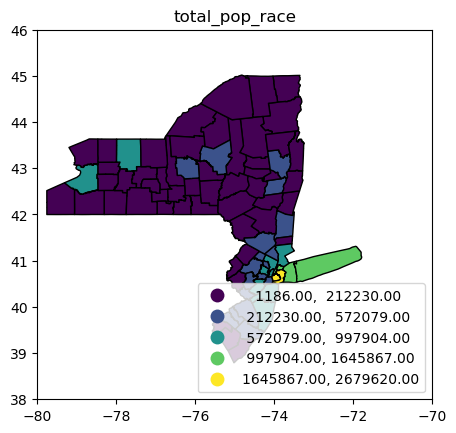

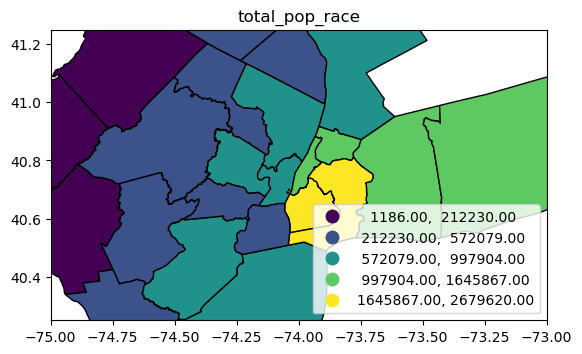

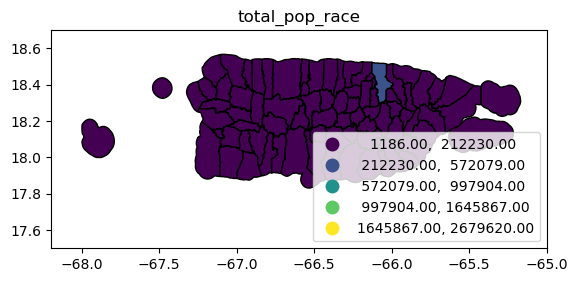

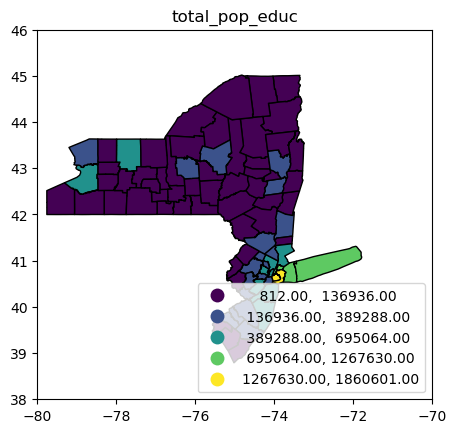

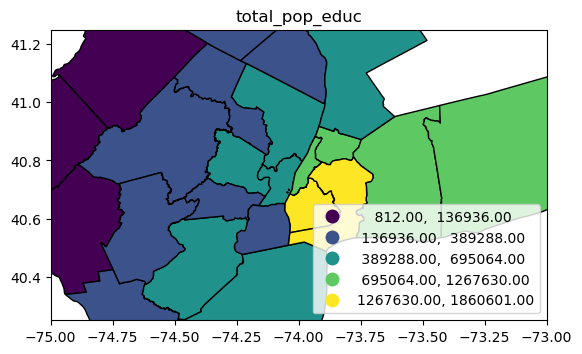

...

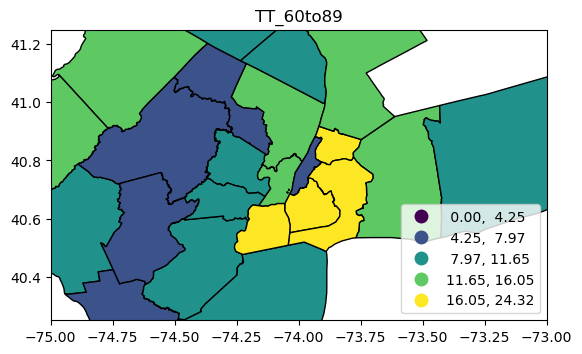

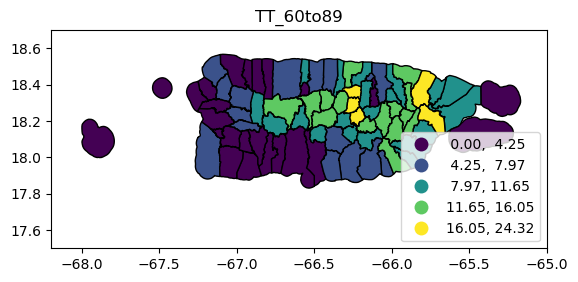

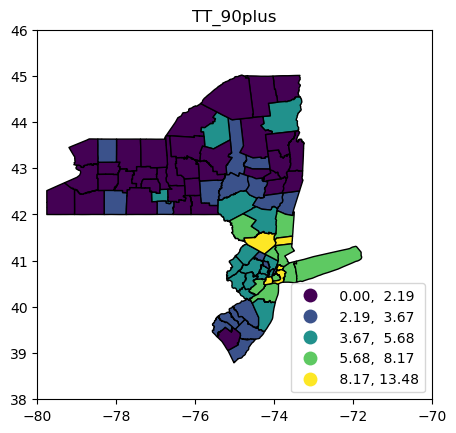

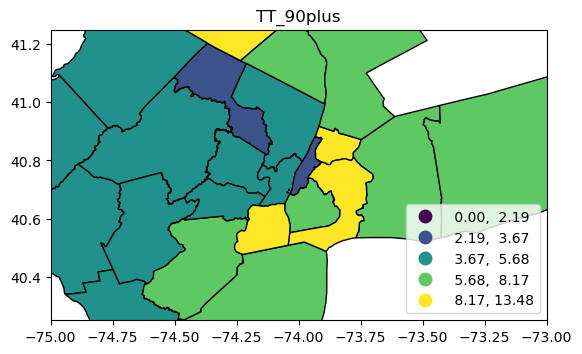

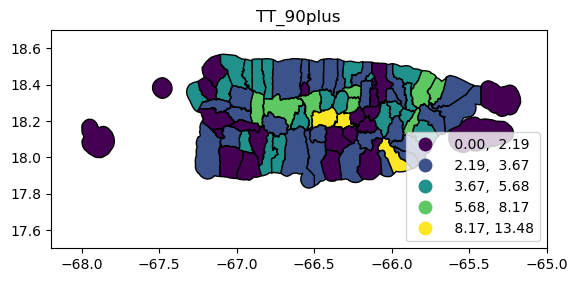

In [39]:
gdf=gpd.GeoDataFrame(df_map)

# Set the coordinate system
gdf = gdf.to_crs("EPSG:4326")

# Avoid memory leak
OMP_NUM_THREADS = 1

for v in all_vars:
    # Now plot NY and NJ
    gdf.plot(column=v, 
             edgecolor='black',
             legend = True,
            scheme = 'natural_breaks',
            legend_kwds={'loc': 'lower right'})

    #Set the latitude and logitude ranges
    plt.xlim(-80,-70)
    plt.ylim(38,46)
    plt.title(v)
    figname = 'NYNJdemmaps/NYNJ_pct_'+v+'.png'
    plt.savefig(figname)
    
    # Zoom into NYC
    gdf.plot(column=v, 
             edgecolor='black',
             legend = True,
            scheme = 'natural_breaks',
            legend_kwds={'loc': 'lower right'})

    #Set the latitude and logitude ranges
    plt.xlim(-75,-73)
    plt.ylim(40.25,41.25)
    plt.title(v)
    figname = 'NYCdemmaps/NYC_pct_'+v+'.png'
    plt.savefig(figname)
    
    # Now plot PR
    gdf.plot(column=v, 
             edgecolor='black',
             legend = True,
            scheme = 'natural_breaks',
            legend_kwds={'loc': 'lower right'})

    #Set the latitude and logitude ranges
    plt.xlim(-68.2,-65)
    plt.ylim(17.5,18.7)
    plt.title(v)
    figname = 'PRdemmaps/PR_pct_'+v+'.png'
    plt.savefig(figname)

In [40]:
df2.head()

,GEOID,GEO_ID,total_pop_race,total_pop_educ,total_hh_inc,total_pop_age,total_pop_emp,total_pop_ind,total_hh_comp,total_hh_veh,...,PeakMorning,LateMorning,Afternoon,Evening,TT_LT15,TT_15to30,TT_30to45,TT_45to59,TT_60to89,TT_90plus
0,34001,0500000US34001,274339,191583,106640,274339,141332,129611,106640,106640,...,42.4040,13.2767,9.6242,9.1743,26.7391,41.8459,17.8255,5.7962,4.6886,3.1047
1,34003,0500000US34003,953243,674596,350843,953243,520767,492359,350843,350843,...,53.0710,14.6358,4.4204,4.4490,21.4112,31.3843,19.8322,9.9031,13.0006,4.4686
2,34005,0500000US34005,461853,329081,174454,461853,245760,233289,174454,174454,...,47.1920,10.3392,6.0255,6.3780,20.8347,34.7743,23.6259,9.4799,7.6926,3.5926
3,34007,0500000US34007,522581,360582,198757,522581,276825,256795,198757,198757,...,44.6963,11.5018,6.8196,7.4311,22.4556,36.4587,22.3558,9.8277,6.0811,2.8209
4,34009,0500000US34009,95456,72532,43277,95456,45141,42214,43277,43277,...,50.3459,12.1055,7.2120,4.9062,37.0491,36.3240,15.0031,4.4553,4.1889,2.9796


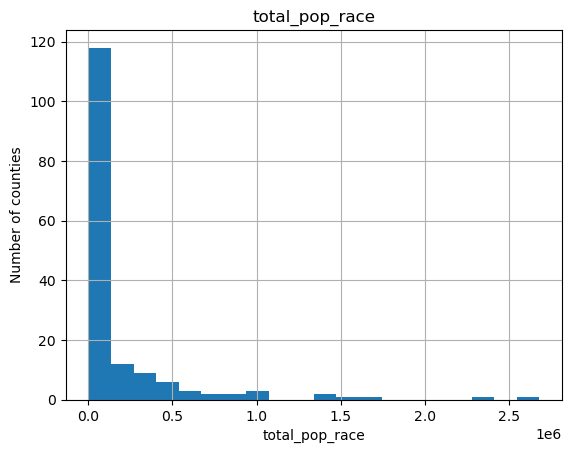

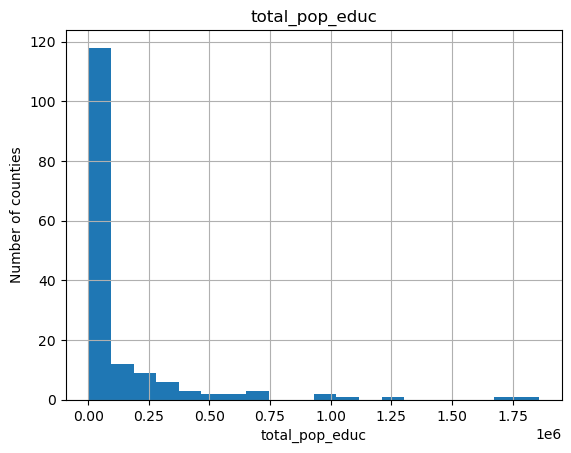

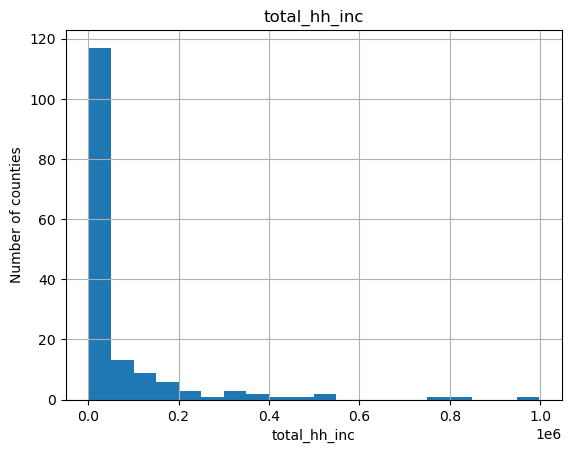

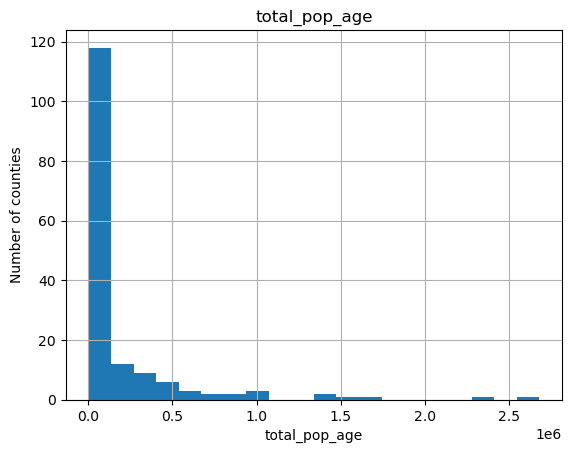

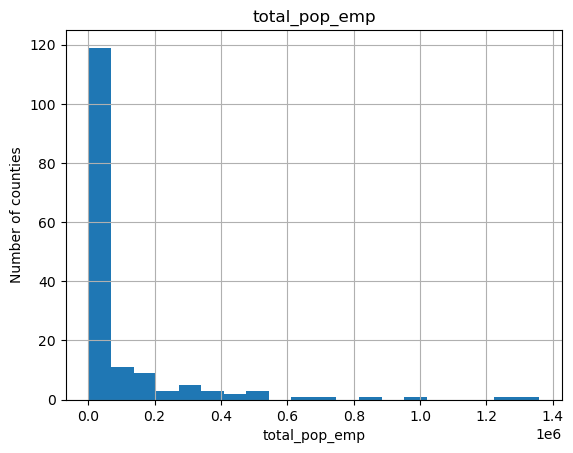

...

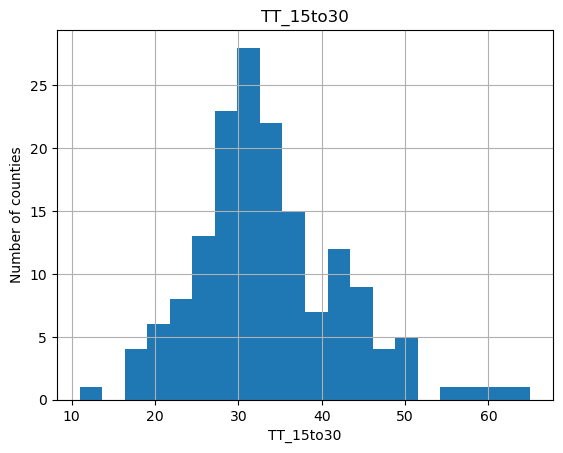

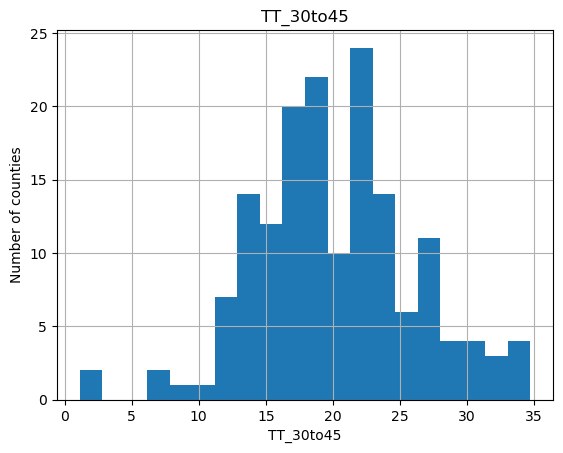

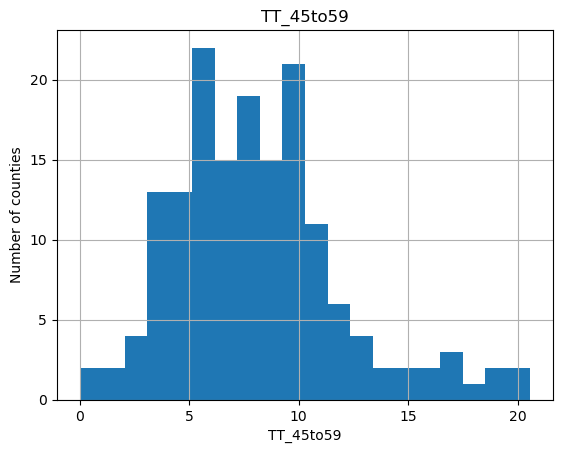

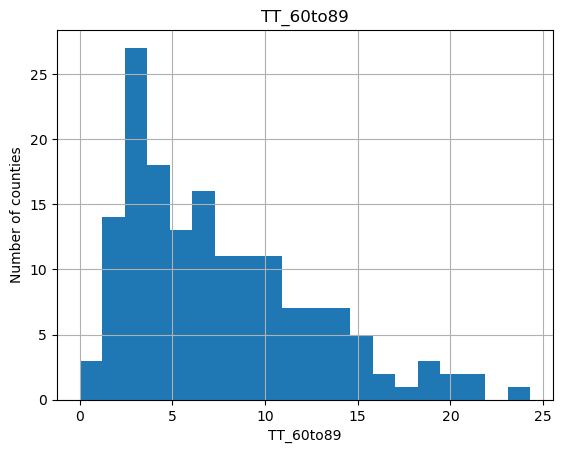

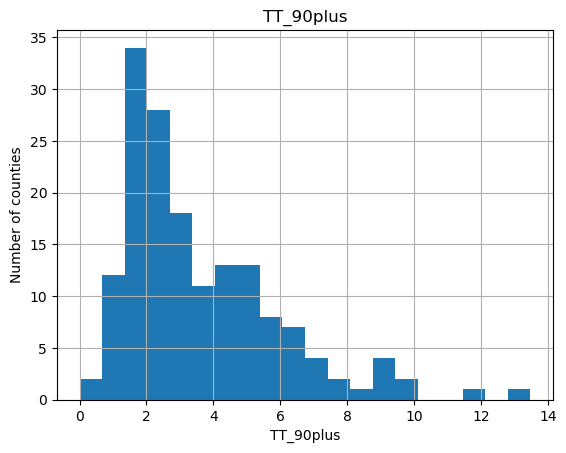

In [47]:
for v in all_vars: 
    df2[v].hist(bins=20)
    plt.xlabel(v)
    plt.ylabel('Number of counties')
    plt.title(v)
    figname = 'histograms/'+v+'.png'
    plt.savefig(figname)
    plt.show()

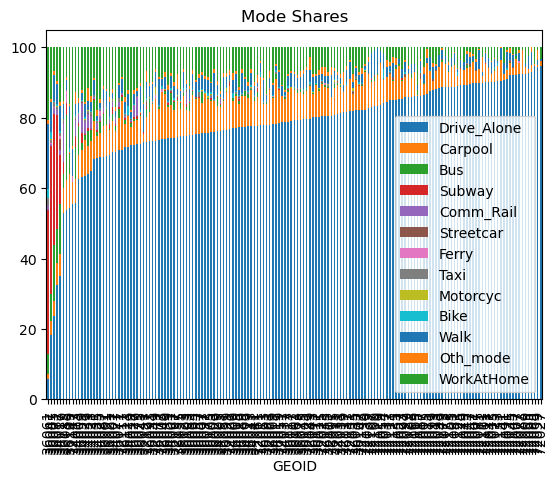

In [48]:
df_modes = df2[['GEOID','Drive_Alone','Carpool', 'Bus', 'Subway', 'Comm_Rail', 'Streetcar', 'Ferry', 
                'Taxi', 'Motorcyc', 'Bike', 'Walk', 'Oth_mode', 'WorkAtHome']]

df_modes = df_modes.sort_values('Drive_Alone')

df_modes.plot(x='GEOID', kind='bar', stacked=True,
        title='Mode Shares')
plt.savefig('otherplots/modes_shares.png')
plt.show()

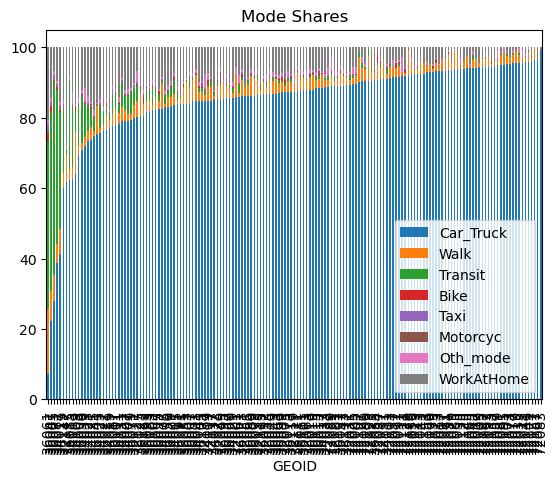

In [49]:
df_modes = df2[['GEOID','Car_Truck','Walk','Transit', 'Bike', 'Taxi', 'Motorcyc','Oth_mode', 'WorkAtHome']]

df_modes = df_modes.sort_values('Car_Truck')

df_modes.plot(x='GEOID', kind='bar', stacked=True,
        title='Mode Shares')
plt.savefig('otherplots/modes_shares_grp.png')
plt.show()

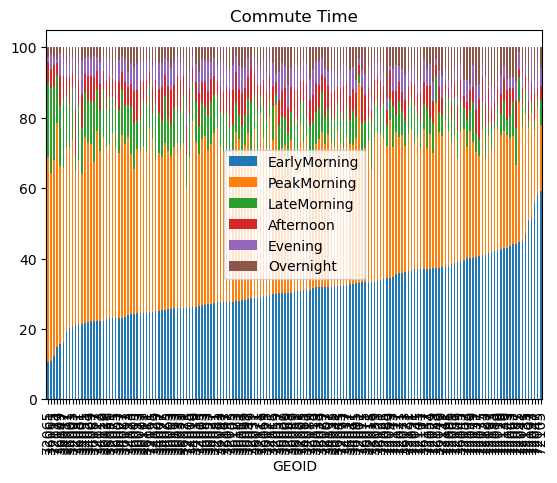

In [50]:
df_tod = df2[['GEOID', 'EarlyMorning','PeakMorning', 'LateMorning', 
              'Afternoon','Evening','Overnight']]

df_tod = df_tod.sort_values('EarlyMorning')

df_tod.plot(x='GEOID', kind='bar', stacked=True,
        title='Commute Time')
plt.savefig('otherplots/commute_time.png')
plt.show()

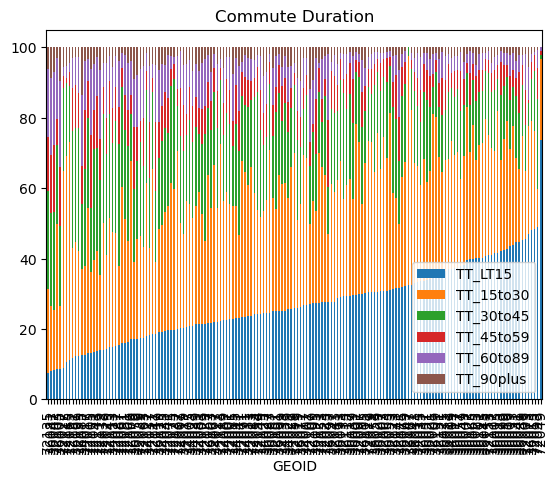

In [52]:
df_dur = df2[['GEOID', 'TT_LT15', 'TT_15to30', 'TT_30to45', 'TT_45to59',
       'TT_60to89', 'TT_90plus']]

df_dur = df_dur.sort_values('TT_LT15')

df_dur.plot(x='GEOID', kind='bar', stacked=True,
        title='Commute Duration')
plt.savefig('otherplots/commute_dur.png')
plt.show()